## *Global Terrorism  is a criminal act that seeks to create fear and terror amongst the general public or a particular group of people for political purposes. It is an unjustifiable means of achieving political, ideological, or religious goals, and is condemned by the international community.*

 **OBJECTIVES**


*   On a data set ‘Global Terrorism’ we perform EDA (‘Exploratory Data Analysis’)

*   to find out the hot zone of terrorism, we act as a security/defense analyst

*   Identify trends and patterns in terrorist activities

*  Study of  the nature  of terrorism, such as the types of attacks, the regions that are most affected, the groups involved, and the factors that contribute to the occurrence of terrorist activities.




## ***Let's import to our data and check the basics.***

In [2]:
from google.colab import drive
drive.mount ('/content/drive')

Mounted at /content/drive


In [3]:
import pandas as pd
import missingno as msno
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots




In [4]:
path = "/content/drive/MyDrive/AlmaBetter Datascience/Datasets/Global Terrorism Data.csv"
df = pd.read_csv(path , encoding = "ISO-8859-1")

<ipython-input-4-9da1a0dd0fbe>:2: DtypeWarning: Columns (4,6,31,33,61,62,63,76,79,90,92,94,96,114,115,121) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(path , encoding = "ISO-8859-1")


In [5]:
df.describe

<bound method NDFrame.describe of              eventid  iyear  imonth  iday approxdate  extended resolution  \
0       197000000001   1970       7     2        NaN         0        NaN   
1       197000000002   1970       0     0        NaN         0        NaN   
2       197001000001   1970       1     0        NaN         0        NaN   
3       197001000002   1970       1     0        NaN         0        NaN   
4       197001000003   1970       1     0        NaN         0        NaN   
...              ...    ...     ...   ...        ...       ...        ...   
181686  201712310022   2017      12    31        NaN         0        NaN   
181687  201712310029   2017      12    31        NaN         0        NaN   
181688  201712310030   2017      12    31        NaN         0        NaN   
181689  201712310031   2017      12    31        NaN         0        NaN   
181690  201712310032   2017      12    31        NaN         0        NaN   

        country         country_txt  regi

**This are the top 10 rows in our dataset**

In [6]:
df.head(10)


,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
5,197001010002,1970,1,1,NaN,0,NaN,217,United States,1,...,"The Cairo Chief of Police, William Petersen, r...","""Police Chief Quits,"" Washington Post, January...","""Cairo Police Chief Quits; Decries Local 'Mili...","Christopher Hewitt, ""Political Violence and Te...",Hewitt Project,-9,-9,0,-9,NaN
6,197001020001,1970,1,2,NaN,0,NaN,218,Uruguay,3,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
7,197001020002,1970,1,2,NaN,0,NaN,217,United States,1,...,"Damages were estimated to be between $20,000-$...",Committee on Government Operations United Stat...,"Christopher Hewitt, ""Political Violence and Te...",NaN,Hewitt Project,-9,-9,0,-9,NaN
8,197001020003,1970,1,2,NaN,0,NaN,217,United States,1,...,The New Years Gang issue a communiqué to a loc...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...","The Wisconsin Cartographers' Guild, ""Wisconsin...",Hewitt Project,0,0,0,0,NaN
9,197001030001,1970,1,3,NaN,0,NaN,217,United States,1,...,"Karl Armstrong's girlfriend, Lynn Schultz, dro...",Committee on Government Operations United Stat...,"Tom Bates, ""Rads: The 1970 Bombing of the Army...","David Newman, Sandra Sutherland, and Jon Stewa...",Hewitt Project,0,0,0,0,NaN


**This are the  last 10 rows in our dataset**

In [7]:
df.tail()



,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
181686,201712310022,2017,12,31,NaN,0,NaN,182,Somalia,11,...,NaN,"""Somalia: Al-Shabaab Militants Attack Army Che...","""Highlights: Somalia Daily Media Highlights 2 ...","""Highlights: Somalia Daily Media Highlights 1 ...",START Primary Collection,0,0,0,0,NaN
181687,201712310029,2017,12,31,NaN,0,NaN,200,Syria,10,...,NaN,"""Putin's 'victory' in Syria has turned into a ...","""Two Russian soldiers killed at Hmeymim base i...","""Two Russian servicemen killed in Syria mortar...",START Primary Collection,-9,-9,1,1,NaN
181688,201712310030,2017,12,31,NaN,0,NaN,160,Philippines,5,...,NaN,"""Maguindanao clashes trap tribe members,"" Phil...",NaN,NaN,START Primary Collection,0,0,0,0,NaN
181689,201712310031,2017,12,31,NaN,0,NaN,92,India,6,...,NaN,"""Trader escapes grenade attack in Imphal,"" Bus...",NaN,NaN,START Primary Collection,-9,-9,0,-9,NaN
181690,201712310032,2017,12,31,NaN,0,NaN,160,Philippines,5,...,NaN,"""Security tightened in Cotabato following IED ...","""Security tightened in Cotabato City,"" Manila ...",NaN,START Primary Collection,-9,-9,0,-9,NaN


##  No of terrorist attacks per year.




In [8]:
attack_per_year=df['iyear'].value_counts()

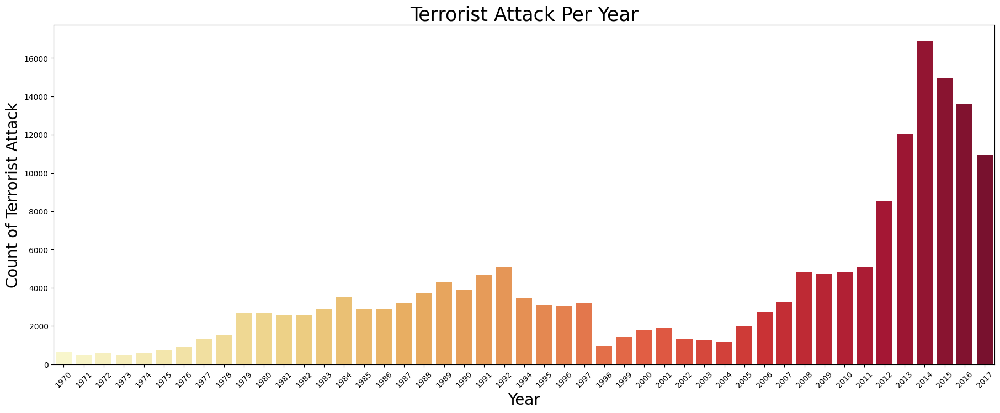

In [9]:
ax=plt.rcParams['figure.figsize'] = 22,8
ax=sns.countplot(x='iyear',palette='YlOrRd',data=df)
ax.set_xlabel('Year',fontsize=20)
plt.xticks(rotation = 45)
ax.set_ylabel('Count of Terrorist Attack',fontsize=20)
ax.set_title('Terrorist Attack Per Year',fontsize=25);

**INFERENCE**:The above graph shows us the amount of attacks took place from year **1970-2017**

' The highest number of attack took place in year **2014** '

## Terrorist Activities by Region in each Year.

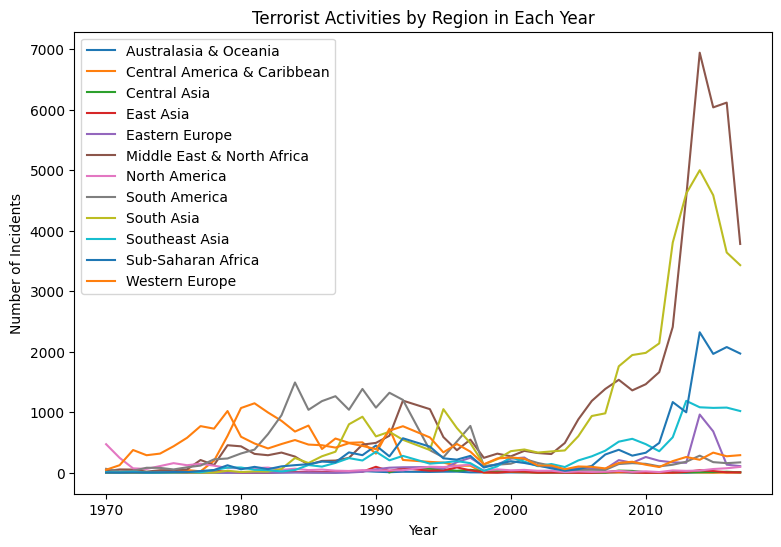

In [10]:
grouped = df.groupby(['region_txt', 'iyear'])['eventid'].count().reset_index()

fig, ax = plt.subplots(figsize=(9,6))
for region in grouped['region_txt'].unique():
    region_data = grouped[grouped['region_txt'] == region]
    ax.plot(region_data['iyear'], region_data['eventid'], label=region)

ax.set_title('Terrorist Activities by Region in Each Year')
ax.set_xlabel('Year')
ax.set_ylabel('Number of Incidents')
ax.legend()
plt.show()


**INFERENCE**: By using Line Chart we have anaylised the terrorist activities in every region of the world in each year
*   The terrorist activities took place more in **western europe** region from mid of  year **1970** till mid of year **1990**
*   And the terrorist activities were more active in **Central America** and **Carribean** region from year **1970** to year **2000** and it has gradually decreased.

*  The terrorist activities which is not decreasing from **year 1970 till now** is **Middle East** and **North Africa** its rather getting increased.

Observation: The **areas affected the most** are **Middle East** and
           **North Africa**



## Top 30 countries been attacked the most.

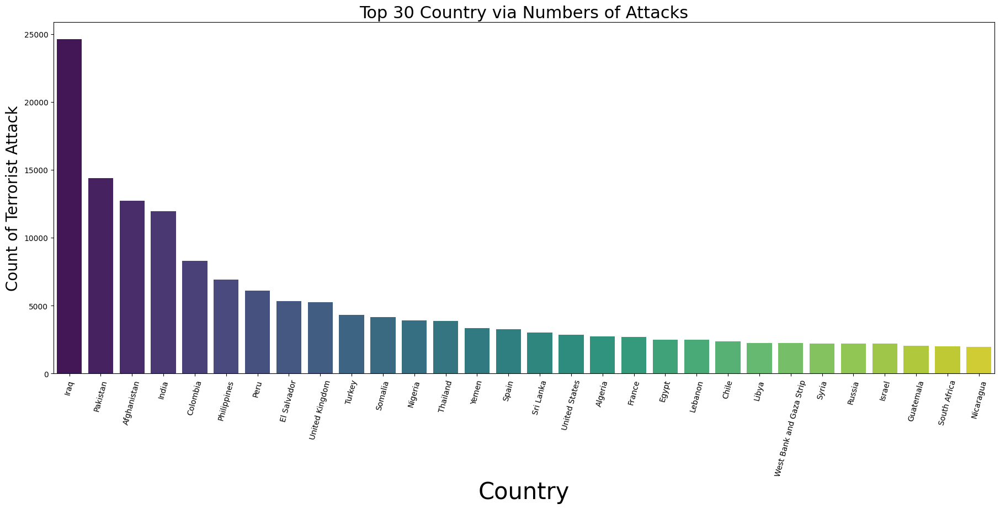

In [11]:
ax=plt.rcParams['figure.figsize'] = 22,8.27
ax=sns.countplot(x='country_txt',palette = 'viridis' ,data=df,order = df['country_txt'].value_counts().index[:30])
ax.set_xlabel('Country',fontsize=30)
plt.xticks(rotation = 75)
ax.set_ylabel('Count of Terrorist Attack',fontsize=20)
ax.set_title('Top 30 Country via Numbers of Attacks',fontsize=22);

**INFERENCE**: Here we have shown Top 30 countries been attacked the most.
             **IRAQ** is on the top list of been attacked most

##Top 30 citites Who have faced the more number of attacks

In [12]:


city_counts = df['city'].value_counts()
print(city_counts.head(10))


Unknown         9775
Baghdad         7589
Karachi         2652
Lima            2359
Mosul           2265
Belfast         2171
Santiago        1621
Mogadishu       1581
San Salvador    1558
Istanbul        1048
Name: city, dtype: int64


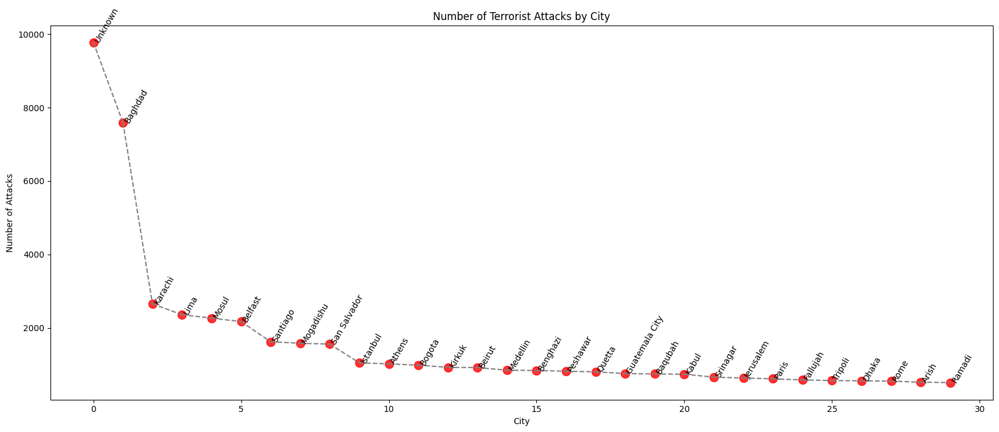

In [13]:
df = df.loc[df['city'].notna()]
city_counts = df['city'].value_counts()
top_cities = city_counts.head(30)
city_df = pd.DataFrame({'city': top_cities.index, 'count': top_cities.values})
fig, ax = plt.subplots(figsize=(20, 8))
for i in range(len(city_df)):
    if i > 0:
        x1, y1 = i - 1, city_df.iloc[i - 1]['count']
        x2, y2 = i, city_df.iloc[i]['count']
        ax.plot([x1, x2], [y1, y2], color='gray', linestyle='--')
ax.scatter(city_df.index, city_df['count'], s=100, c='red', alpha=0.8)
for i, row in city_df.iterrows():
    ax.text(i, row['count'], row['city'], fontsize=10, rotation=60)
ax.set_xlabel('City')
ax.set_ylabel('Number of Attacks')
ax.set_title('Number of Terrorist Attacks by City')
plt.show()


**INFERENCE**: To analyze the data to search which cities the terrorist attack took place most we have used scattered plot. and top 30 cities are displayed on **the top** are the cities which are **unknown** and the **2nd most top city** is **Baghdad**

# Terrorist agencies and their success rate

Lets visualize the top active agencies and how successful they are in their attack

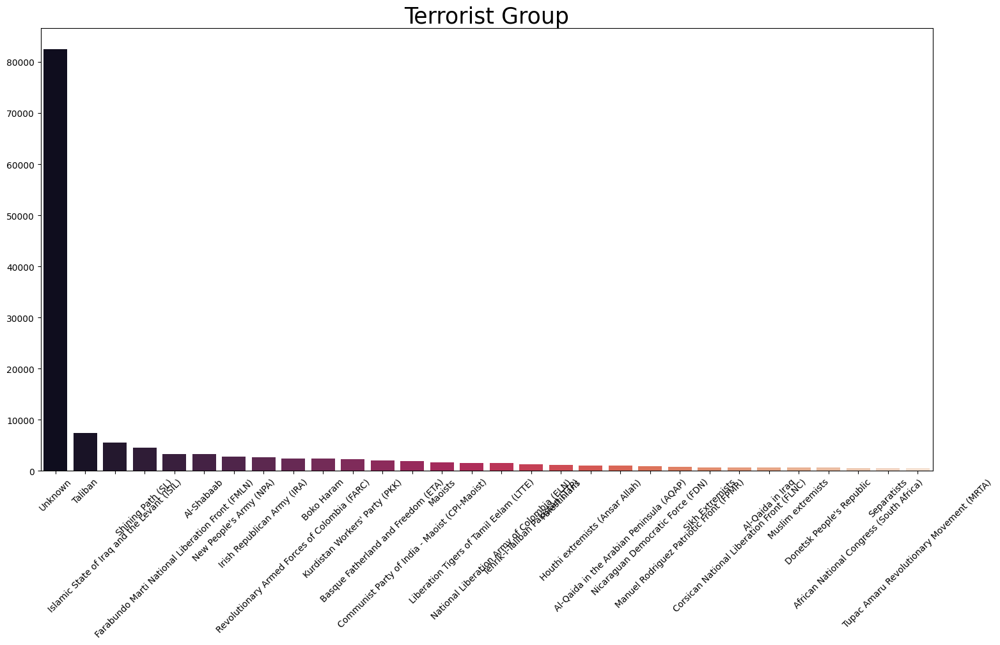

In [14]:

ax=plt.rcParams['figure.figsize'] = 18,9
ax = sns.countplot(x='gname', palette='rocket', data=df,order = df['gname'].value_counts().index[:30])
ax.set_title('Terrorist Group',fontsize=25)
ax.set_xlabel('',fontsize=8)
ax.set_ylabel('')
ax.tick_params(axis='x', rotation=45)
plt.show()

Here we have used bar chart to analyise the top 30 groups of terrorist who have done most of the attacks overall

**On the top** is the **Unknown** group. This means its not a single group but they belong to different groups with certain motives, and they are not active all the time and not so popular.

**Second most active group** of terrorist is **Taliban**

# The weapons mostly used by the agencies in attacks

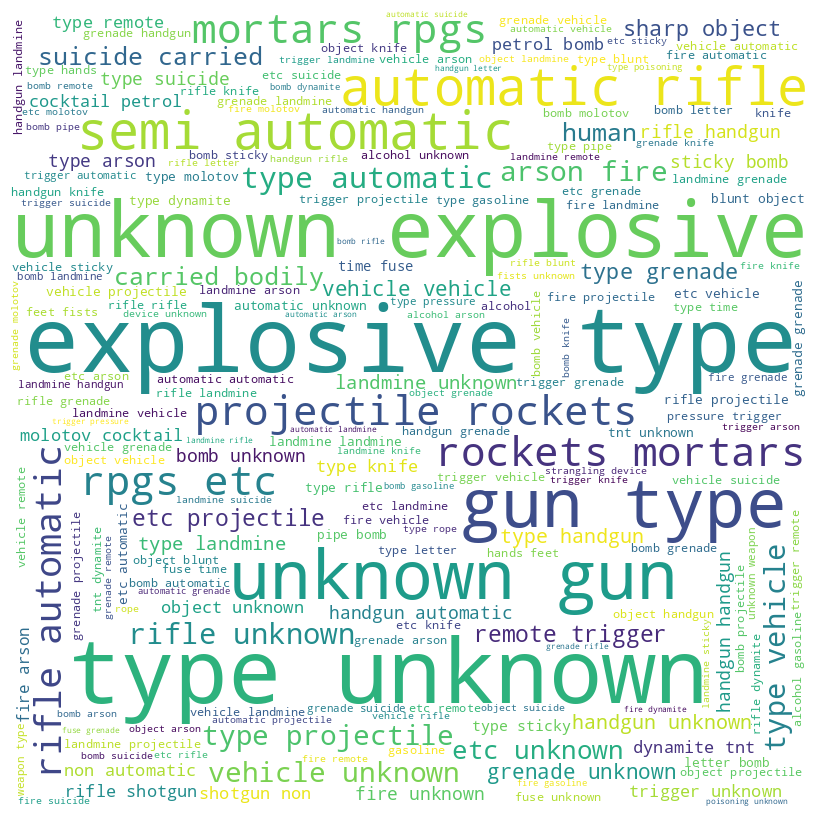

In [15]:

from wordcloud import WordCloud


cities = df['weapsubtype1_txt'].dropna().astype(str).str.lower().str.cat(sep=' ')#str.cat(sep=' ') method to concatenate all the city names with a space separator.


wordcloud = WordCloud(width=800, height=800, background_color='white').generate(cities)
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis('off')
plt.tight_layout(pad=0)
plt.show()


**Inference:** Here we have visualised the type of **weapons most frequently used** by the Terrorist Agencies using **Wordcloud**, i.e **Explosives** .

#  Top 30 Weapons Used in Terrorist Attacks Based on Average Death per Attack


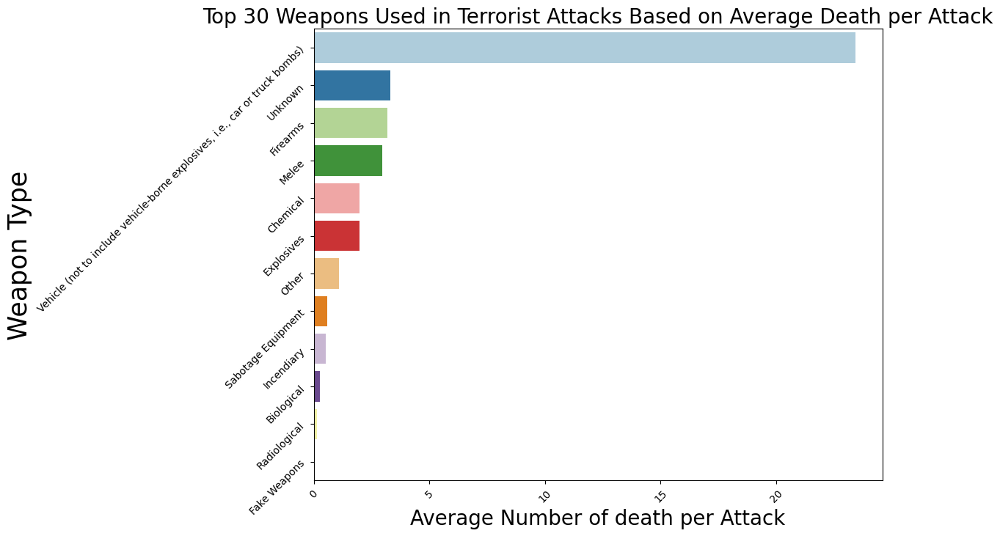

In [16]:

df_weapons = df.groupby('weaptype1_txt')['nkill'].mean().reset_index()
df_weapons = df_weapons.sort_values('nkill', ascending=False)
top_30_weapons = df_weapons.head(30)
fig, ax = plt.subplots(figsize=(10,8))
sns.barplot(x='nkill', y='weaptype1_txt', data=top_30_weapons, palette='Paired', ax=ax)
ax.set_title('Top 30 Weapons Used in Terrorist Attacks Based on Average Death per Attack', fontsize=20)
ax.set_xlabel('Average Number of death per Attack', fontsize=20)
ax.set_ylabel('Weapon Type', fontsize=25)
ax.tick_params(axis='x', rotation=45)
ax.tick_params(axis='y', rotation=45)
plt.show()


**The most used weapon used in terrorist attack** and it is the most sucessful one:
   **Truck bombing** or **Vehicle bombing**.

Means  A truck or car or bus is  loaded with **explosives**, used as a bomb blasting technique.

# Types of attacks

 Different types of attacks used by terrorists visulazised below using pie chart




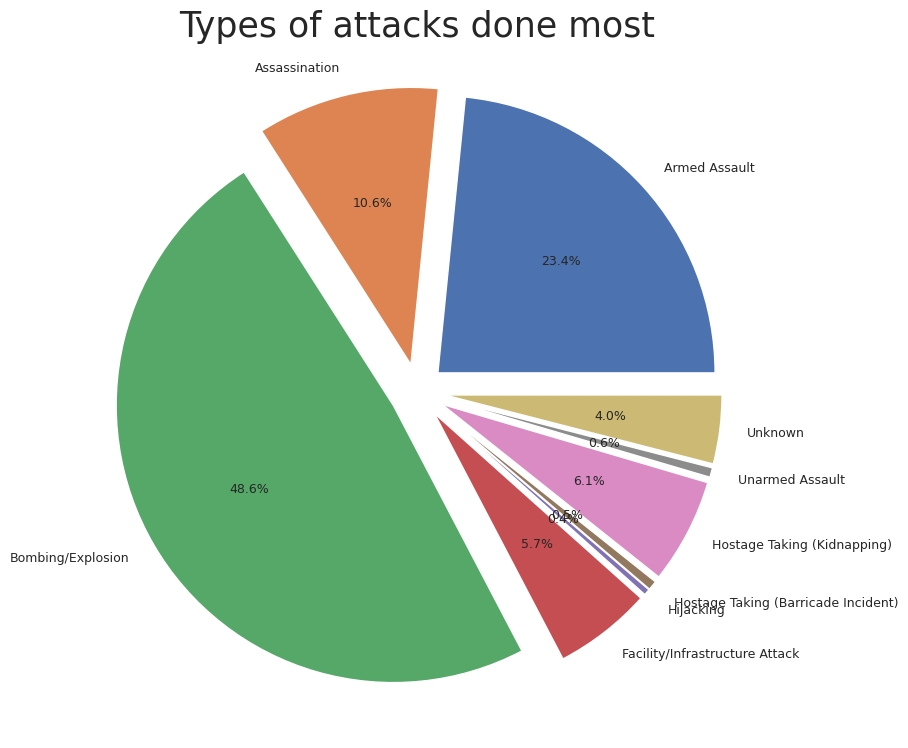

In [29]:
#8
df_grouped = df.groupby('attacktype1_txt').size().reset_index(name='counts')
explode = (0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1)
plt.pie(df_grouped['counts'], labels=df_grouped['attacktype1_txt'], autopct='%1.1f%%',explode=explode, textprops={'fontsize': 9})
plt.title("Types of attacks done most",fontsize=25 )
plt.show()


**INFERENCE**: Here we have used a Pie chart and analysed that the attack was mostly done by the **Bombing/Explosion**. i.e **48.6%** among all

# The deaths, injuries and loss of properties caused due to the attacks

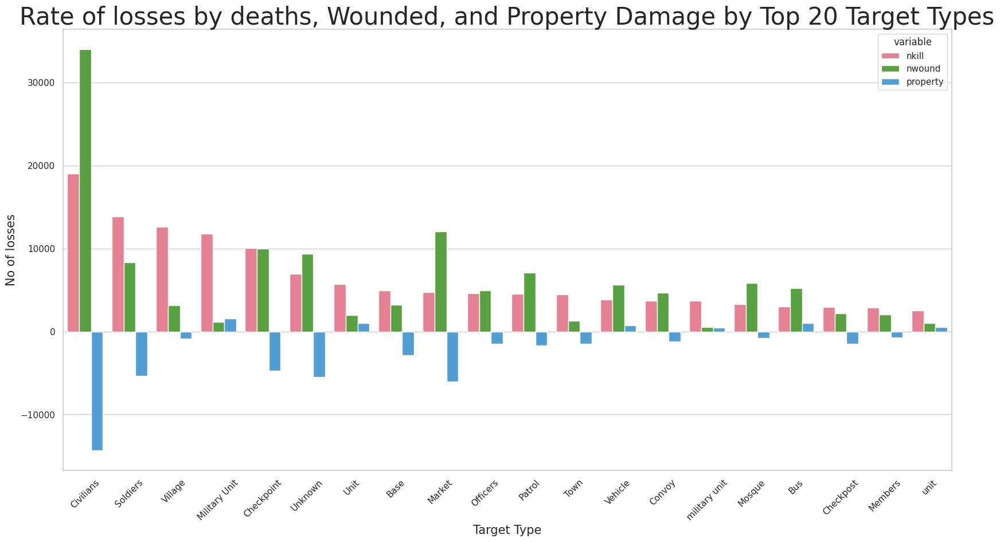

In [30]:

sns.set_theme(style='whitegrid')

df_top_targets = df.groupby('target1')[['nkill', 'nwound', 'property']].sum().sort_values('nkill', ascending=False).head(20).reset_index()

plt.figure(figsize=(20, 10))
ax = sns.barplot(x='target1', y='value', hue='variable', data=pd.melt(df_top_targets, id_vars='target1'),palette='husl')
ax.set_title('Rate of losses by deaths, Wounded, and Property Damage by Top 20 Target Types',fontsize=30)
ax.set_xlabel('Target Type',fontsize=15)
ax.set_ylabel('No of losses',fontsize=15)

ax.tick_params(axis='x', rotation=45)

plt.show()



**INFERENCE**: The Analysis of losses after the terrorist attack we have used the group bar chart, where the **rate of wounded and death of the civilians are more**.

#Top 30 Countries Facing Highest Number of Casualties in Terrorist Attacks


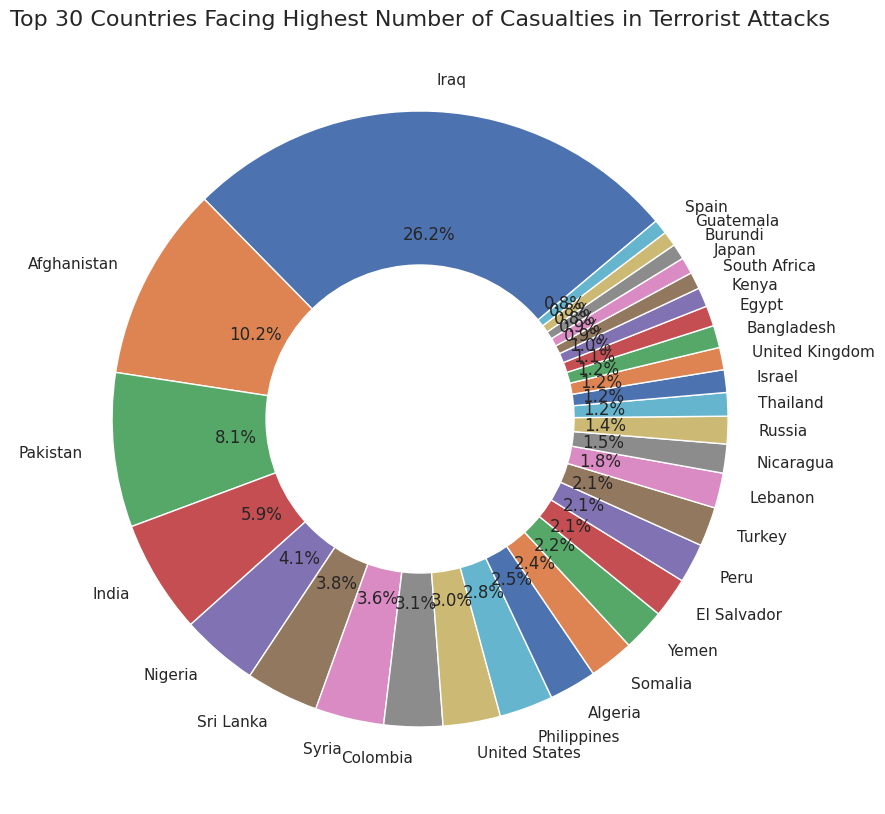

In [31]:

df_casualties = df.groupby('country_txt')[['nkill', 'nwound']].sum().reset_index()
df_casualties['total_casualties'] = df_casualties['nkill'] + df_casualties['nwound']
df_top_casualties = df_casualties.sort_values('total_casualties', ascending=False).head(30)
plt.figure(figsize=(10, 10))
plt.pie(df_top_casualties['total_casualties'], labels=df_top_casualties['country_txt'], autopct='%1.1f%%', startangle=40)
centre_circle = plt.Circle((0, 0), 0.50, fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title('Top 30 Countries Facing Highest Number of Casualties in Terrorist Attacks', fontsize=16)
plt.show()


**INFERENCE**: The country which has faced hightest no of casulaties is **Iraq** (**26.2**%) , 2nd place its **Afghanistan**  (**10.2**%) and **Pakistan** (**8.1**%) is in 3rd place. These are the **top 3 countries faced the highest no. of deaths** throughout the time period,  analysed using doughnut pie chart.

#Countries which have faced the highest number of GunsAttack

In [32]:
df_gunsAttack = df.query("gname == 'Unknown'").groupby(["country_txt"])["nkill"].count()
df_gunsAttack

country_txt
Afghanistan            4672
Albania                  75
Algeria                1168
Angola                   61
Antigua and Barbuda       0
                       ... 
Yemen                   989
Yugoslavia              122
Zaire                    33
Zambia                   29
Zimbabwe                 53
Name: nkill, Length: 192, dtype: int64

In [33]:
pd.options.plotting.backend = "plotly"
fig = df_gunsAttack.plot()
fig.show()




**INFERENCE**: **Iraq** is the country, faced the highest no. of casualities caused by "**Guns Attack**".

This is the visualizaton of Terrorist activities which are various types of **Guns Assault** directly to the **civillians** of different countries with their amount of **Severity** across the years.

**Top 5 Countries in the list with their numbers are:**
* **Iraq** - 18,287
* **Pakistan** - 10,691
* **Afghanistan** - 4735
* **India** - 4191
* **Thailand** - 3002

#Countries with highest no. of human casualities caused by Bombing/Explotion.

In [28]:
df_bomb = df.query('attacktype1_txt == "Bombing/Explosion"').groupby(['country_txt']).agg({'nkill': 'count'})
df_bomb.sort_values(by=['nkill'] , ascending=False)


,nkill
country_txt,
Iraq,18046
Pakistan,7578
Afghanistan,6167
India,4781
Colombia,3015
...,...
People's Republic of the Congo,1
Guinea,1
Belize,1


**INFERENCE**: **Iraq** is the country **suffered most no. of explotions** and is leading the list by a big margin to its successors **Pakistan(2nd)** , **Afghanistan(3rd)** and **India at the 4th position**.

# **Geospacial Visualization** using Follium Marker-Cluster.

We are visualising data of attacks took place in a **single year** and we have selected **year 2014** since it is the **year with most no. of attacks**.

In [34]:
import folium
from folium.plugins import MarkerCluster
filterYear = df['iyear'] == 2014

In [35]:
filterData = df[filterYear] # filter data
# filterData.info()
reqFilterData = filterData.loc[:,'city':'longitude'] #We are getting the required fields
reqFilterData = reqFilterData.dropna() # drop NaN values in latitude and longitude
reqFilterDataList = reqFilterData.values.tolist()
# reqFilterDataList

In [36]:
map = folium.Map(location = [0, 30], tiles='CartoDB positron', zoom_start=2)
# clustered marker
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(reqFilterDataList)):
    folium.Marker(location=[reqFilterDataList[point][1],reqFilterDataList[point][2]],
                  popup = reqFilterDataList[point][0]).add_to(markerCluster)
map



Location wise Global Terrorist Attacks have been visualized for the year "**2014**", since this is the **Year in which most no. of attacks took place** and we can see that, **Middle East** and **South East Asia** are the most attacked regions.

#***CORRELATION HEATMAP***

<ipython-input-37-57ee4a8719fb>:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



<Axes: >

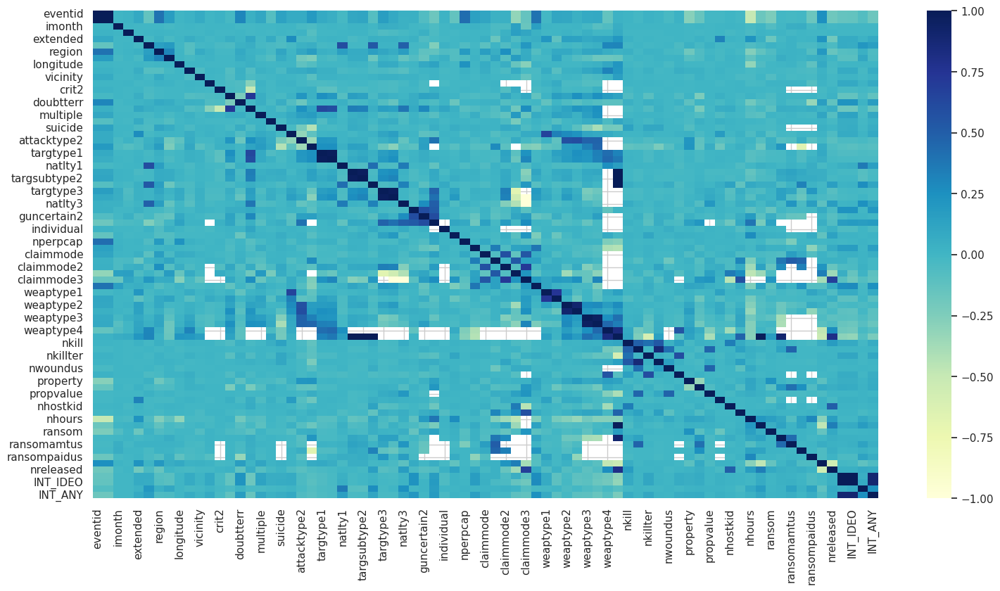

In [37]:
sns.heatmap(df.corr(),cmap="YlGnBu")



This is the **correlation heatmap** and by visualsing this we got a lot of insights for any further Machine Learning approaches to be applied on this dataset.
Some of these insights look like:

* **'targsubtype2'** and **'targtype3'** columns are highly correlated with **'weaptype4'** and **'weapsubtype4'** columns.
* **nkill** is highly correlated with **'ndays'** ,**'ransomamt'**,**'targtype2'**, **'targsubtype2'** and **'natlty2'**  columns.
* **'attacktype2'** has partially good correlation with **'weaptype1'** but not so significant correlation with **'weapsubtype1'**.
etc.

In this dataset there are **135 columns** and clearly not all the columns are important at the same time, we can do a lot of **feature engineering** here to fit the data into  **Machine Learning algorithms** as per our requirements.

**PRATIK**

 We first decided to take up this project solely due to our mutual interest in Global Terrorism Factor.We Selected this project because it has a lot of columns and therefore lot of visualizations could be possible.
When I started exploring the dataset, I found lot of different types of columns which gave rise to various types of ideas to visualize the Terrorism activities. Most importantly, the "**latitude**" and "**Longitude**" columns, looking at these two columns I could easily visualize the data Geospacially.

 Some of my key findings were:

* The terrorism activities and the attacks were done mostly in the Western regions like **Europe, America** etc. But across the years the incidents started to shift from there to the **Middle East and South Asia** regions.

* Muslim majority countries  **Iraq, Afghanistan, Pakistan** have been damaged the most in terms of human casualities as well as property damage.

**SWETA**

During my analysis of terrorist attacks, I found that the year **2014** had the highest number of attacks. To identify the cities with the most incidents, I initially attempted to visualize the data using a pie chart, but it didn't provide clear insights. However, when I switched to a scatter plot, I observed that the top-ranked cities were categorized as **unknown**, indicating they were lesser-known or smaller cities. Surprisingly, **Baghdad** emerged as the second-most targeted city.
The primary method of attack used by terrorists was Bombing/Explosion, accounting for **46.7%** of all cases, while **hijacks** were less frequent. The impact on civilians in terms of injuries, deaths, and property losses was significant. **Iraq, Afghanistan, and Pakistan** were the countries most affected by terrorist attacks, with Iraq experiencing the highest number of casualties. Notably, gun attacks resulted in the highest number of casualties in **Ireland**.

**AJAY**

During my analysis of terrorist attacks, I found that bombing and explosion and armed assault mostly done, The terrorist activity took place more in **western Europe** from mid of year 1970 to mid of year 1990, And the terrorist activity was more active in Central America and Caribbean from year 1970 to year 2000 and its gradually getting less, and top 30 cities are displayed on the top are the cities which are **unknown** and the 2nd most top city is **Baghdad**. As I see that bombing/explosion was mostly done and in the other part as I see that **Countries with highest no. of human causalities caused by Bombing/Explosion.** in Africa most highest number of bombing/explosion was done that means they easily make or get the explosive material for attack and as we seen **Terrorist Activities by Region in each Year** Sub-Saharan Africa all this kept on increasing but Middle East and North Africa everything was stable here so there was a fault in the  security system of Sub-Saharan Africa.

#**Conclusion**


Country with the most attacks:   **Iraq**

City with the most attacks:   **Baghdad**

Region with the most attacks:   **Middle East** & **North Africa**

Year with the most attacks:   **2014**


Group with the most attacks:   **Taliban**

Most Attack Types:   **Bombing**/**Explosion**

 The terrorist attacks  took place most oftenly is in **Iraq** and the success rate is also high in **Iraq** which indicates very low security for its citizens.

On 2nd place is **Pakistan** And on 3rd is **Afghanistan**

 ***If we look at the graphics, it appears that Iraq, Afghanistan and Pakistan are the most damaged countries. All of these countries are Muslim countries.***